In [15]:
from diffusers import AutoPipelineForText2Image
import torch

In [29]:
pipeline = AutoPipelineForText2Image.from_pretrained(
	"stable-diffusion-v1-5/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
generator = torch.Generator("cuda").manual_seed(30)


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

### Generated images with all the Prompts only using generator, giving manual seed 30.

**Prompt1**

In [3]:
prompt1 = "The image is an abstract painting with a marbled texture. The colors are primarily brown, gray, and white, with a hint of light blue. The shapes are organic and flowing, with no distinct lines. The painting has a modern, contemporary feel and would be perfect for a stylish home or office."

  0%|          | 0/50 [00:00<?, ?it/s]

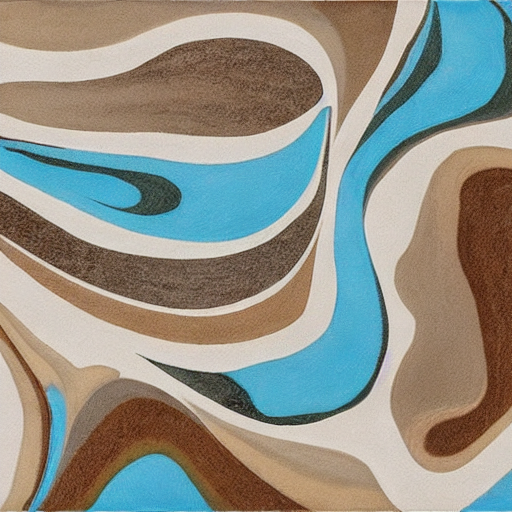

In [ ]:
image1 = pipeline(prompt1, generator=generator).images[0]
image1

In [ ]:
image1.save(f"generated_image_1.png")

**Prompt2**

In [ ]:
prompt2 ="The image is a seamless pattern of multicolored dots. The dots are arranged in wavy horizontal lines, with each line having a different color. The colors are all warm and earthy, and include shades of brown, orange, yellow, and green. The pattern has a hand-drawn feel, and is reminiscent of traditional Aboriginal dot painting. The overall mood of the image is calming and serene."

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['calming and serene .']


  0%|          | 0/50 [00:00<?, ?it/s]

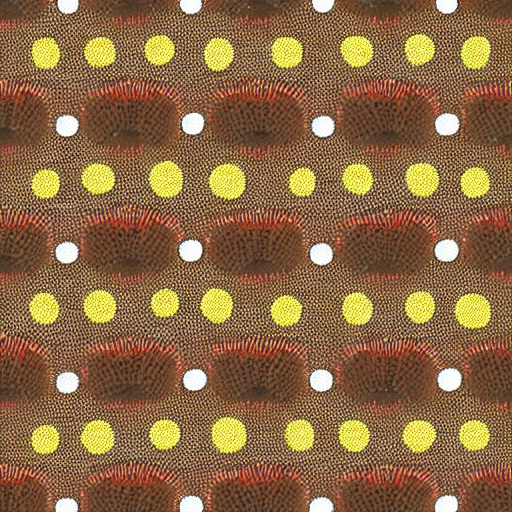

In [ ]:
image2 = pipeline(prompt2, generator=generator).images[0]
image2

In [ ]:
image2.save(f"generated_image_2.png")

**Tried to run prompt2 with different seeds in the generator but not getting very satisfactory results with this prompt.**



The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['calming and serene .']


  0%|          | 0/50 [00:00<?, ?it/s]

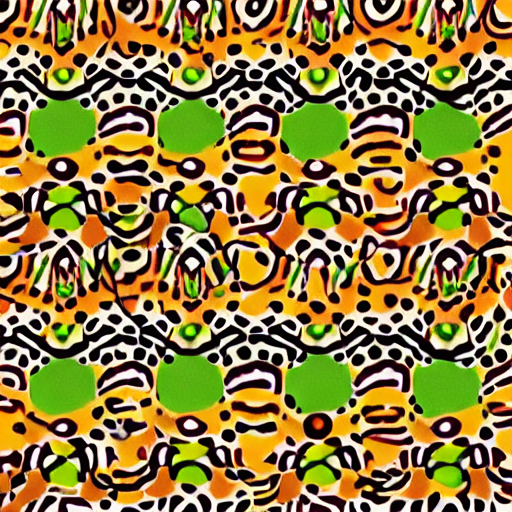

In [ ]:
image3 = pipeline(prompt2, generator=generator).images[0]
image3

In [ ]:
image3.save(f"generated_image_3.png")

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['calming and serene .']


  0%|          | 0/50 [00:00<?, ?it/s]

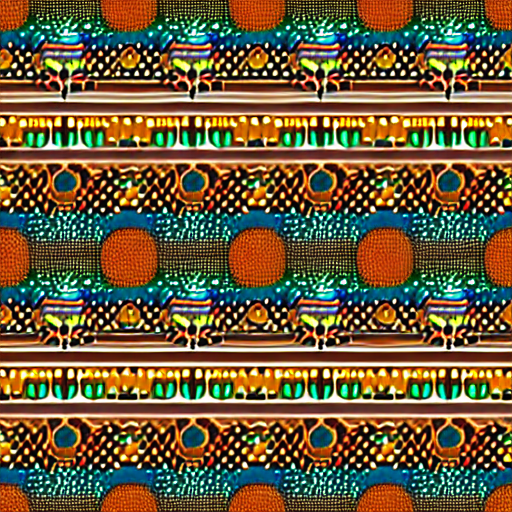

In [35]:
generator1 = torch.Generator("cuda").manual_seed(40)
image4 = pipeline(prompt2, generator=generator1).images[0]
image4

**Prompt3**

In [13]:
prompt3 = "This seamless pattern showcases a mesmerizing display of swirling organic shapes resembling delicate vines. The intricate, Art Nouveau-inspired design is composed of varying shades of blue, from deep sapphire to pale cerulean, offset against a soft white background. The pattern exudes a sense of timeless elegance and would be ideal for applications such as wallpaper, fabric, or home decor."

  0%|          | 0/50 [00:00<?, ?it/s]

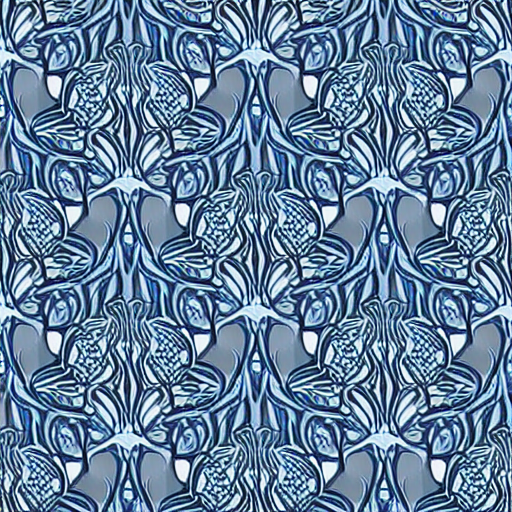

In [ ]:
image5 = pipeline(prompt3, generator=generator).images[0]
image5

In [ ]:
image5.save(f"generated_image_5.png")

 **Tried to give some creative prompts for wallpaper or some textile design**

 prompt4, prompt5, prompt6 ,prompt7, prompt8 - new prompts I tried to generate some unique styles.

**Prompt4**

In [ ]:
prompt4 = "A celestial theme with constellations, moons, and stars in shades of navy blue and gold for a magical vibe."

  0%|          | 0/50 [00:00<?, ?it/s]

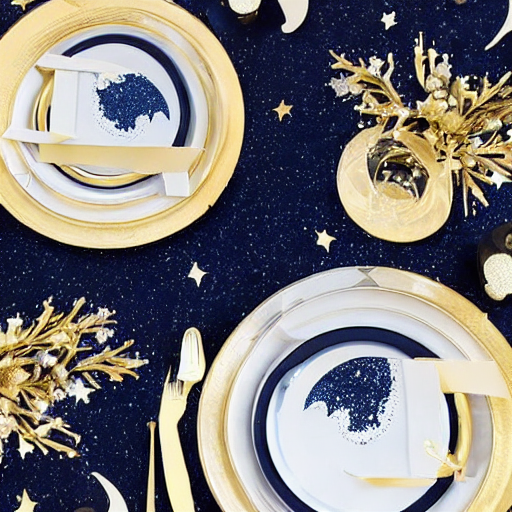

In [ ]:
image6 = pipeline(prompt4, generator=generator).images[0]
image6

In [ ]:
image6.save(f"generated_image_6.png")

**Prompt5**

In [ ]:
prompt5 = "A seamless pattern of watercolor peonies and roses with soft pastel hues on a beige background, elegant and modern for home wallpaper."

  0%|          | 0/50 [00:00<?, ?it/s]

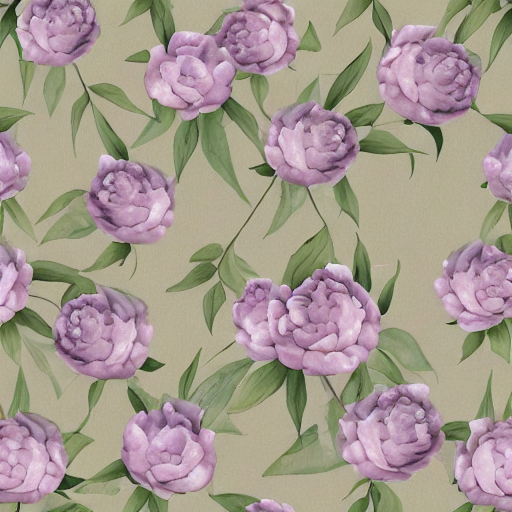

In [ ]:
generator5 = torch.Generator("cuda").manual_seed(35)
image7 = pipeline(prompt5, generator=generator5).images[0]
image7

In [ ]:
image7.save(f"generated_image_7.png")

**Prompt6**

In [ ]:
prompt6 = "A textile fabric with tiny decorative beads or sequins and colored with dyes to create a wavy pattern."

  0%|          | 0/50 [00:00<?, ?it/s]

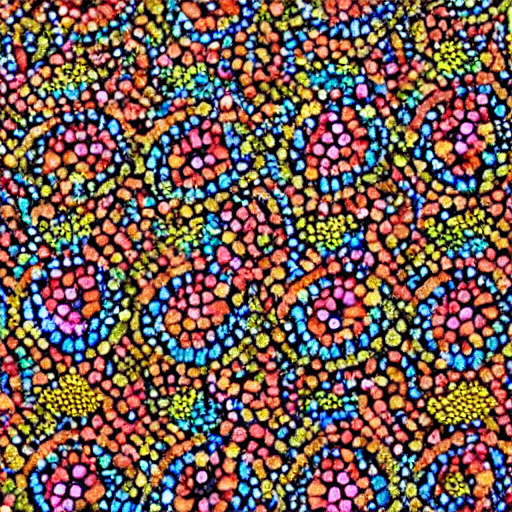

In [ ]:
generator6 = torch.Generator("cuda").manual_seed(42)
image8 = pipeline(prompt6, generator=generator6).images[0]
image8

In [ ]:
image8.save(f"generated_image_8.png")

**Prompt7**

  0%|          | 0/50 [00:00<?, ?it/s]

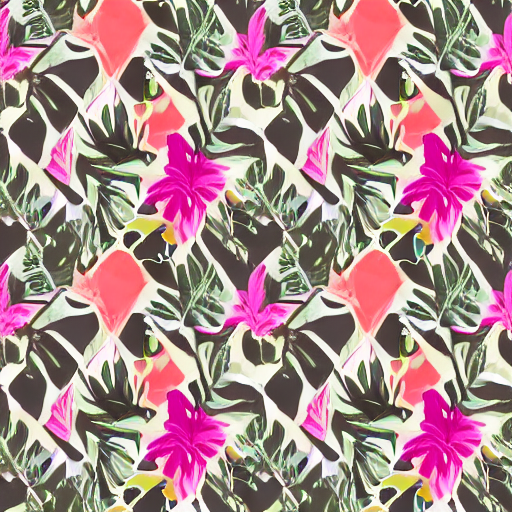

In [ ]:
prompt8 = "Tropical floral patterns with geometric overlays in muted colors."
generator7 = torch.Generator("cuda").manual_seed(31)
image9 = pipeline(prompt8, generator=generator7).images[0]
image9

In [ ]:
image9.save(f"generated_image_10.png")

**Prompt8**

  0%|          | 0/50 [00:00<?, ?it/s]

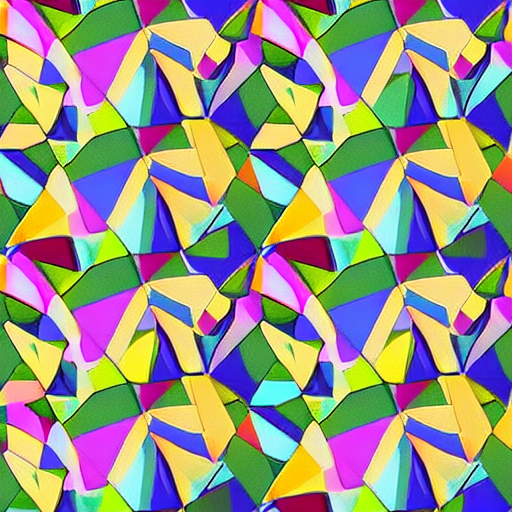

In [ ]:
prompt7 = "Bright and colorful geometric shapes overlapping like a kaleidoscope, creating a cheerful wallpaper."
generator7 = torch.Generator("cuda").manual_seed(30)
image10 = pipeline(prompt7, generator=generator7).images[0]
image10

In [ ]:
image10.save(f"generated_image_11.png")

Tried prompt4 with different seeds and modifying the prompts.
**Prompt :** "A celestial theme with constellations, moons, and stars in shades of navy blue and gold for a magical vibe. Make it in warm tone"



In [18]:
prompt9 = "A celestial theme with constellations, moons, and stars in shades of navy blue and gold for a magical vibe. Make it in warm tone"

  0%|          | 0/50 [00:00<?, ?it/s]

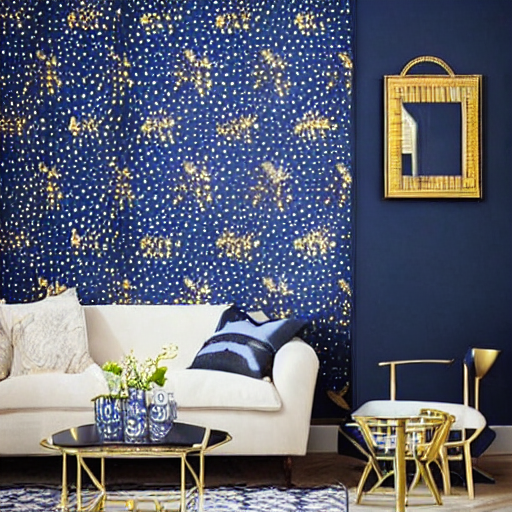

In [21]:
generator7 = torch.Generator("cuda").manual_seed(40)
image14 = pipeline(prompt9, generator=generator7).images[0]
image14

### * **Using Controlnet for finetuning the model to generate the images with some additional condition with all the prompts and given a pose image to the stable-diffuser model 1.5**

In [4]:
from diffusers import ControlNetModel, AutoPipelineForText2Image
from diffusers.utils import load_image
import torch


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [5]:

controlnet = ControlNetModel.from_pretrained(
	"lllyasviel/control_v11p_sd15_openpose", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
pose_image = load_image("https://huggingface.co/lllyasviel/control_v11e_sd15_shuffle/resolve/main/images/input.png")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/999 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/723M [00:00<?, ?B/s]

In [23]:
pipeline = AutoPipelineForText2Image.from_pretrained(
	"stable-diffusion-v1-5/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16, variant="fp16"
).to("cuda")
generator = torch.Generator("cuda").manual_seed(31)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

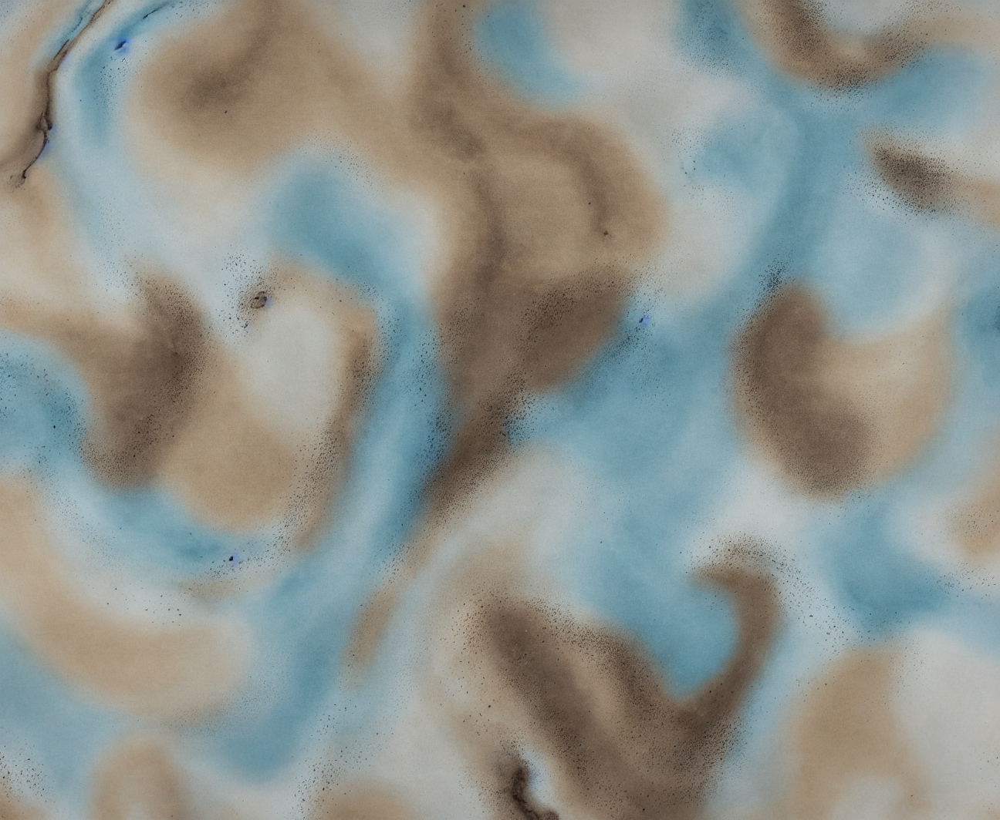

In [5]:
prompt1 = "The image is an abstract painting with a marbled texture. The colors are primarily brown, gray, and white, with a hint of light blue. The shapes are organic and flowing, with no distinct lines. The painting has a modern, contemporary feel and would be perfect for a stylish home or office."
image12 = pipeline(prompt1, image=pose_image, generator=generator).images[0]
image12

In [9]:
image12.save(f"generated_images_12.png")

**Added height and weight parameter to get it in a wallpaper design format.**

  0%|          | 0/50 [00:00<?, ?it/s]

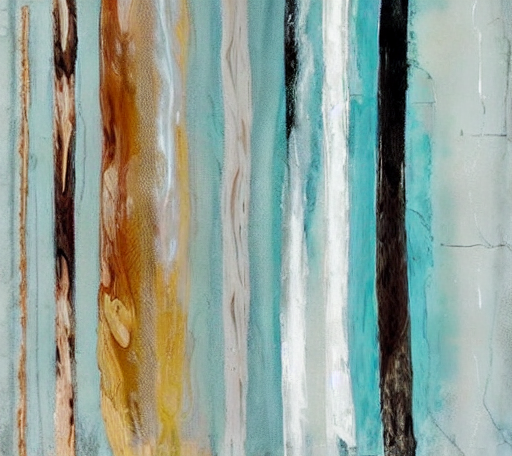

In [10]:
image13 = pipeline(prompt1, image=pose_image, generator=generator, height=460, width=512).images[0]
image13


In [11]:
image13.save(f"generated_images_13.png")

## With Prompt2

Token indices sequence length is longer than the specified maximum sequence length for this model (81 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['calming and serene .']


  0%|          | 0/50 [00:00<?, ?it/s]

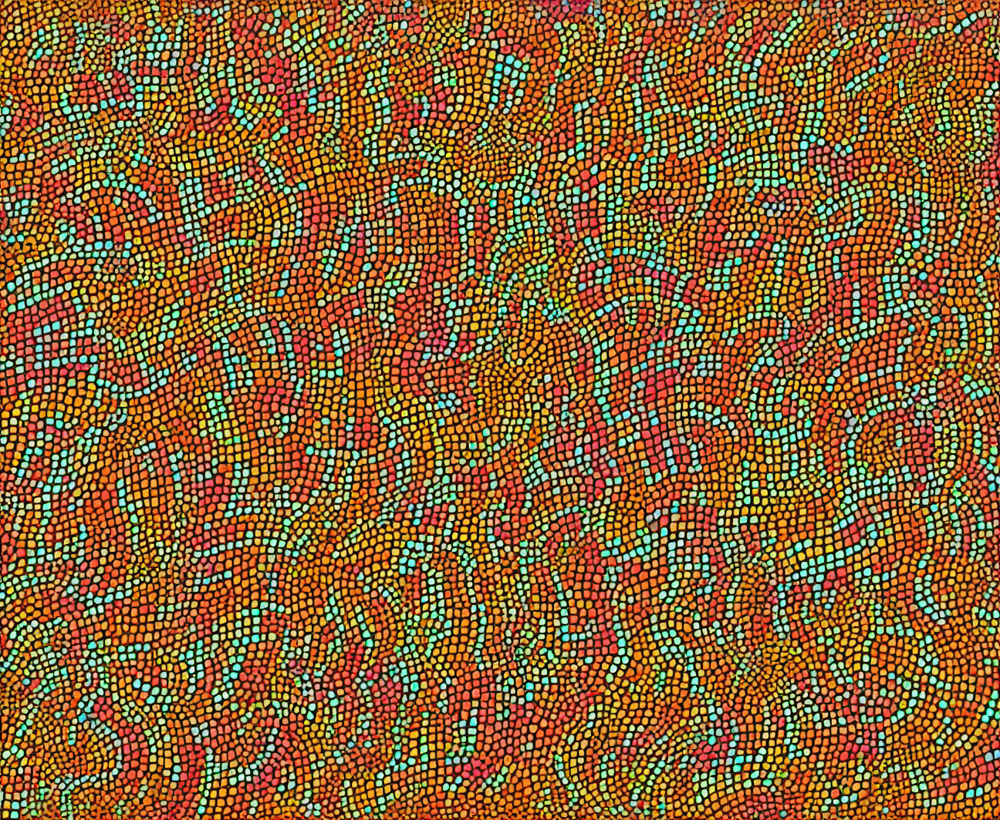

In [6]:
prompt2 ="The image is a seamless pattern of multicolored dots. The dots are arranged in wavy horizontal lines, with each line having a different color. The colors are all warm and earthy, and include shades of brown, orange, yellow, and green. The pattern has a hand-drawn feel, and is reminiscent of traditional Aboriginal dot painting. The overall mood of the image is calming and serene."
image14 = pipeline(prompt2, image=pose_image, generator=generator).images[0]
image14

In [10]:
image14.save(f"generated_images_14.png")

NameError: name 'image15' is not defined

Token indices sequence length is longer than the specified maximum sequence length for this model (81 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['calming and serene .']


  0%|          | 0/50 [00:00<?, ?it/s]

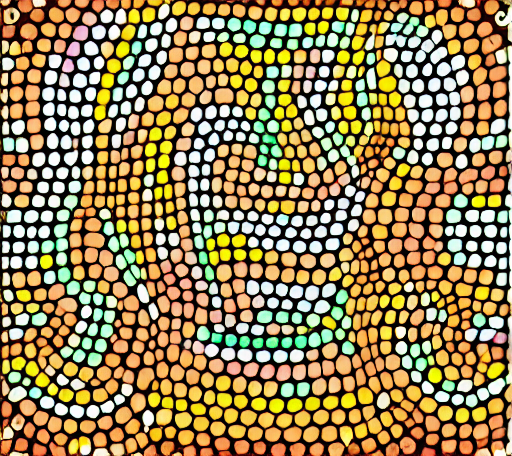

In [8]:
prompt2 ="The image is a seamless pattern of multicolored dots. The dots are arranged in wavy horizontal lines, with each line having a different color. The colors are all warm and earthy, and include shades of brown, orange, yellow, and green. The pattern has a hand-drawn feel, and is reminiscent of traditional Aboriginal dot painting. The overall mood of the image is calming and serene."
image15 = pipeline(prompt2, image=pose_image, generator=generator, height=460, width=512).images[0]
image15

In [11]:
image15.save(f"generated_images_15.png")

With Prompt3


  0%|          | 0/50 [00:00<?, ?it/s]

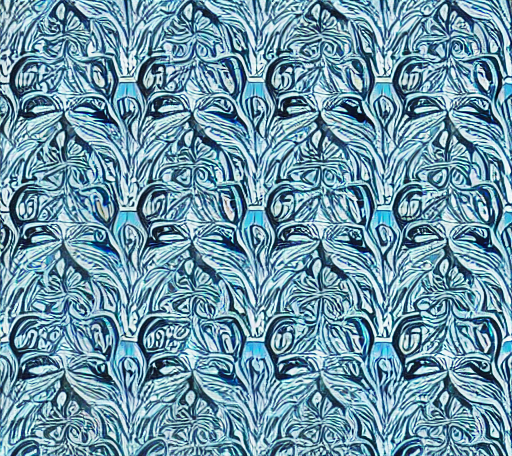

In [12]:
prompt3 ="This seamless pattern showcases a mesmerizing display of swirling organic shapes resembling delicate vines. The intricate, Art Nouveau-inspired design is composed of varying shades of blue, from deep sapphire to pale cerulean, offset against a soft white background. The pattern exudes a sense of timeless elegance and would be ideal for applications such as wallpaper, fabric, or home decor."
image16 = pipeline(prompt3, image=pose_image, generator=generator, height=460, width=512).images[0]
image16

With Prompt4

Modified prompts: Tried to make it more unique in giving prompts

  0%|          | 0/50 [00:00<?, ?it/s]

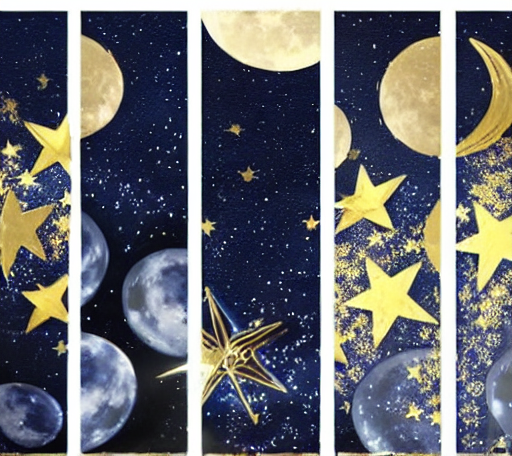

In [20]:
prompt4 = "A celestial theme with constellations, moons, and stars in shades of navy blue and gold for a magical vibe for home decor."
image17 = pipeline(prompt4, image=pose_image, generator=generator, height=460, width=512).images[0]
image17


  0%|          | 0/50 [00:00<?, ?it/s]

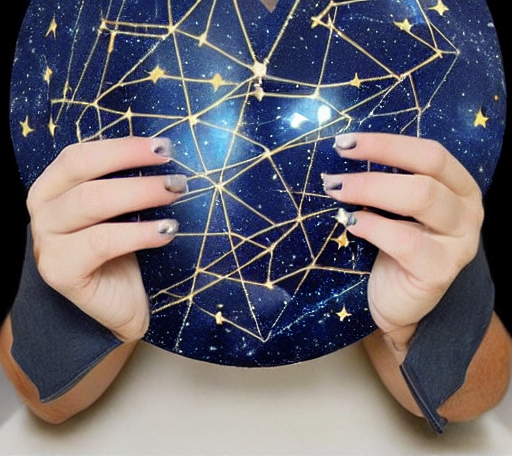

In [21]:
prompt4 = "A celestial theme with constellations, moons, and stars in shades of navy blue and gold for a magical vibe for home decor. Feel of the image should be like space"
image18 = pipeline(prompt4, image=pose_image, generator=generator, height=460, width=512).images[0]
image18

With Prompt5

  0%|          | 0/50 [00:00<?, ?it/s]

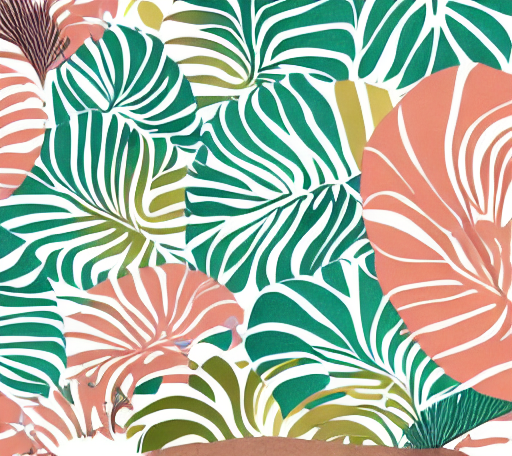

In [25]:
prompt5 = "Tropical floral patterns with geometric overlays in muted colors."
image19 = pipeline(prompt5, image=pose_image, generator=generator, height=460, width=512).images[0]
image19

With Prompt6

  0%|          | 0/50 [00:00<?, ?it/s]

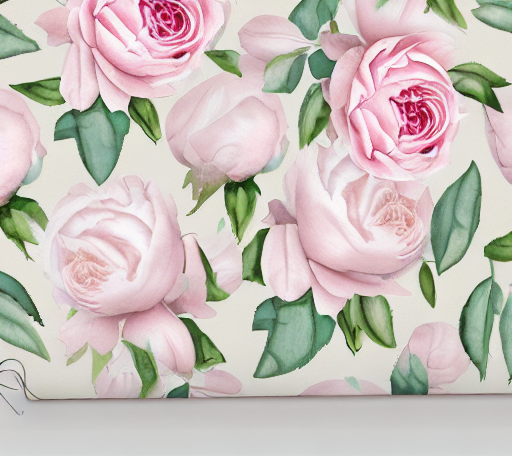

In [28]:
prompt6 = "A seamless pattern of watercolor peonies and roses with soft pastel hues on a beige background, elegant and modern for home wallpaper."
image20 = pipeline(prompt6, image=pose_image, generator=generator, height=460, width=512).images[0]
image20